In [1]:
from data import get_hf_data, get_t_data
from funcs import *

import pandas as pd
import matplotlib.pyplot as plt
import ds_functions as ds
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.mixture import GaussianMixture
from sklearn.cluster import AgglomerativeClustering

# Heart Failure

In [6]:
hf_data = get_hf_data(filter_outliers=True, feature_selection=True)
hf_data.pop('DEATH_EVENT')

pass

## Clustering

### K-Means

100%|██████████| 15/15 [00:02<00:00,  6.67it/s]


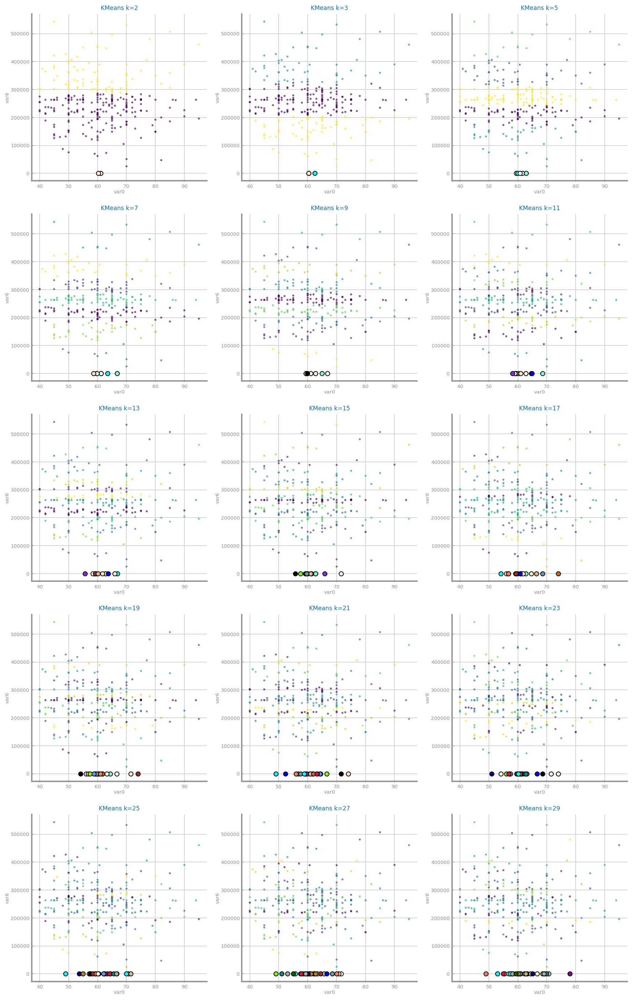

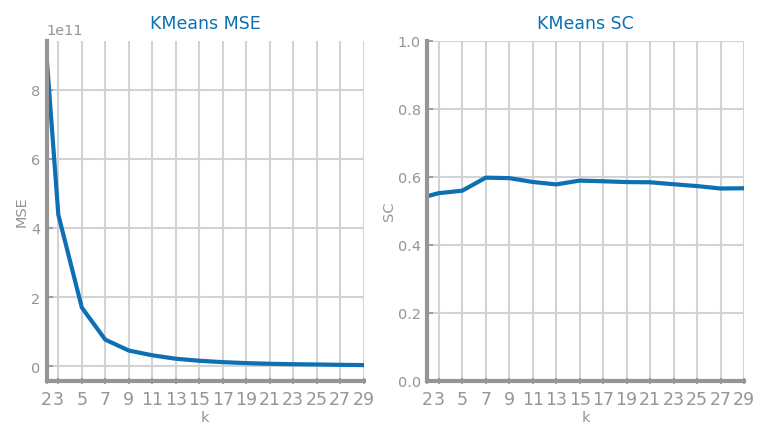

In [7]:
N_CLUSTERS = [2, 3, 5, 7, 9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29]
cluster_Kmeans(hf_data, 6, 0, N_CLUSTERS, estimatorType='Kmeans')

### EM (Expectation-Maximization)

100%|██████████| 15/15 [00:01<00:00,  8.47it/s]


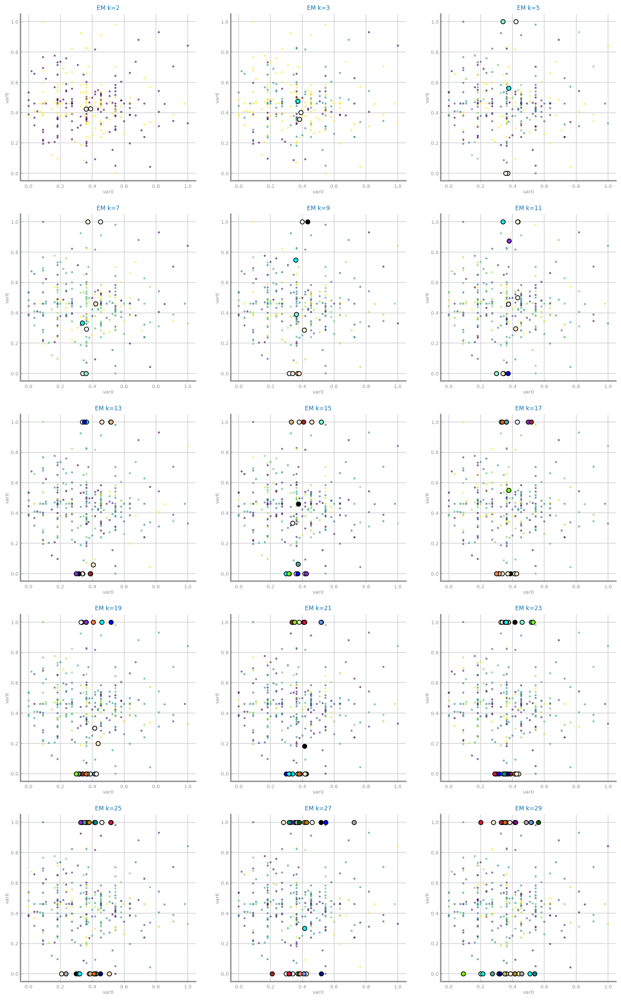

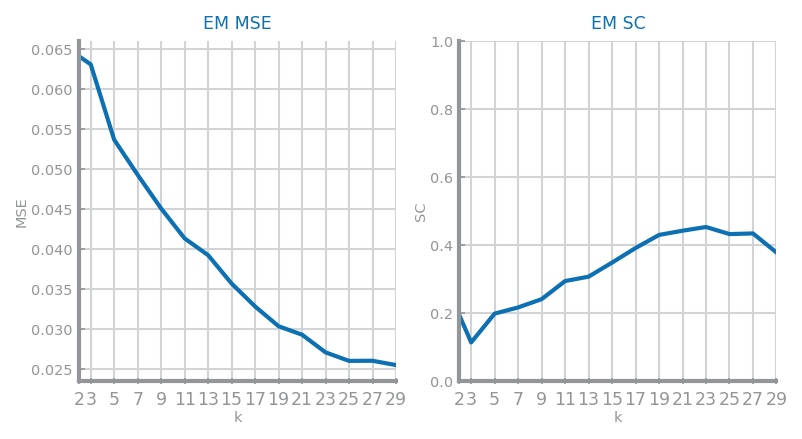

In [4]:
cluster_Kmeans(hf_data, 6, 0, N_CLUSTERS, estimatorType='Gaussian')

### Density-based

#### EPS - studying the maximum distance impact

100%|██████████| 12/12 [00:00<00:00, 19.09it/s]


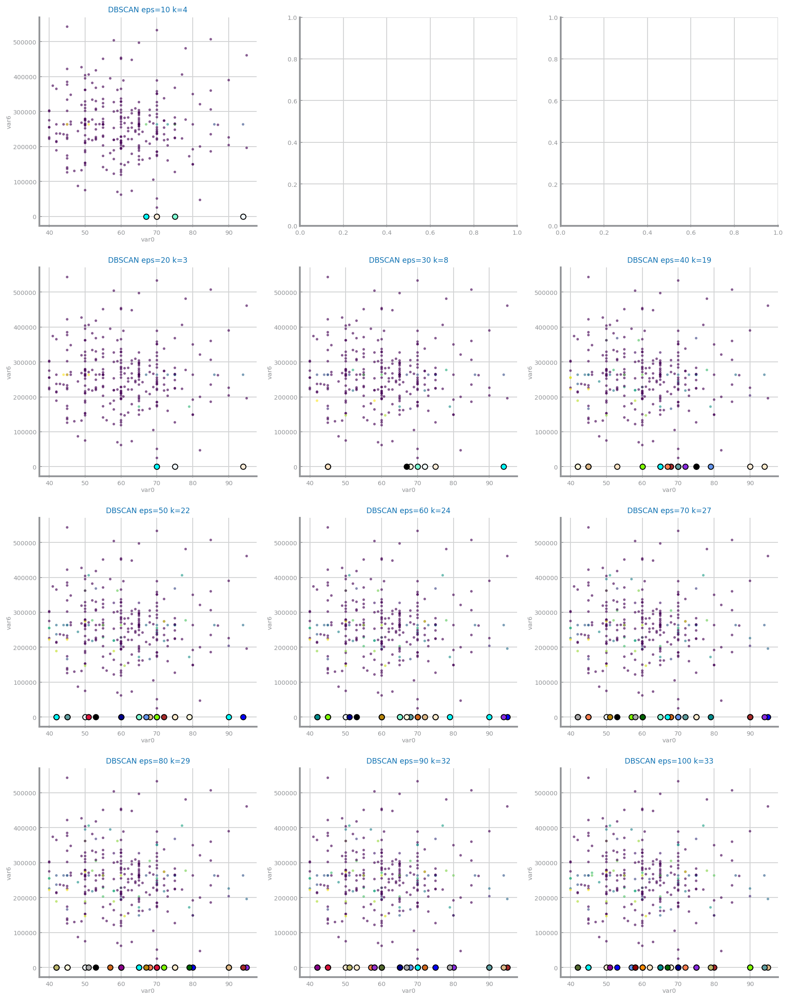

In [16]:
EPS = [2.5, 5, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
densityBasedCluster(hf_data, 6, 0, EPS)

### Metric

AVG distances among records [93193.49785337009, 93705.26385101576, 93184.73714742347, 1.3013859016515793e-05, 0.8520855198663637]
CHOSEN EPS [55916.09871202205, 80, 55910.84228845408, 1.3013859016515794e-06, 0.12781282797995455]


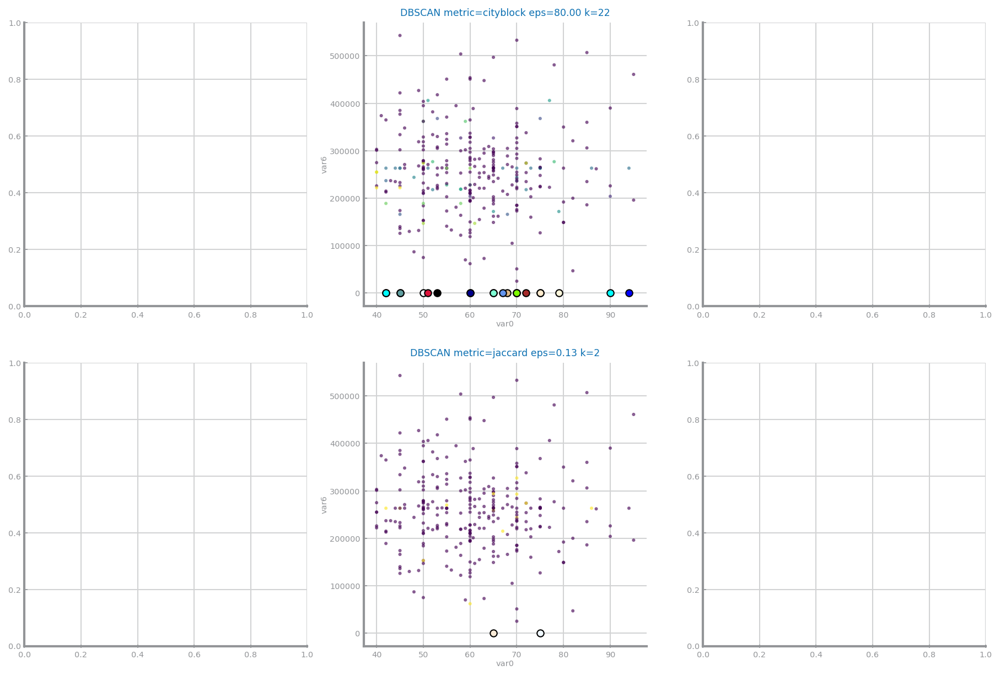

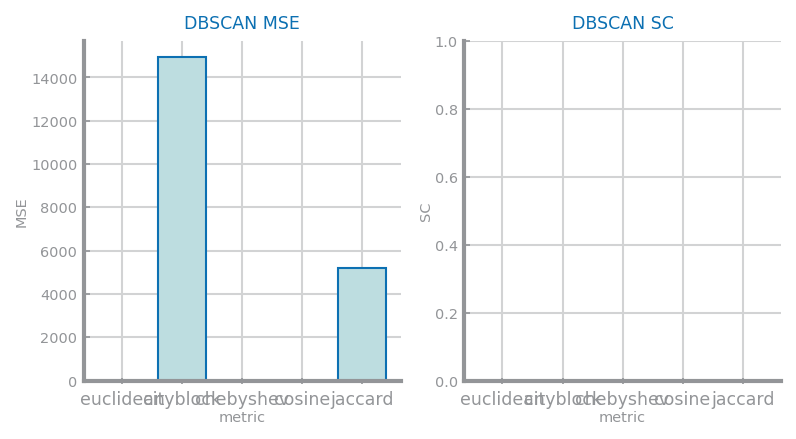

In [15]:
metric(hf_data, 6, 0)

### Hierachical

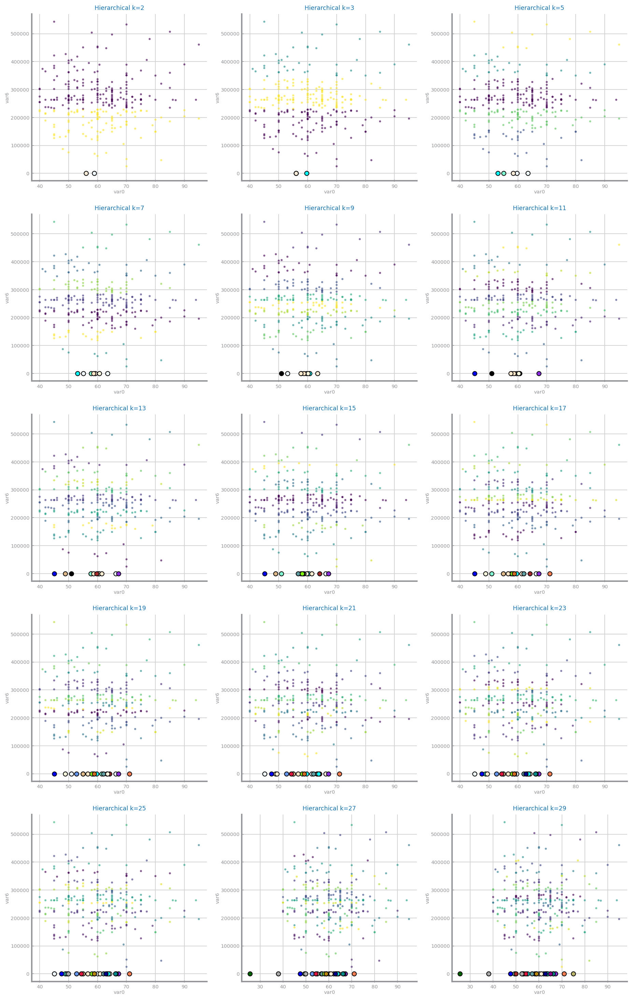

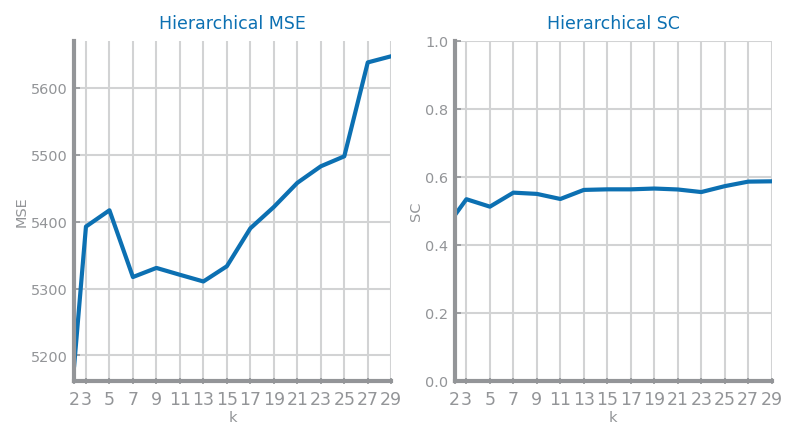

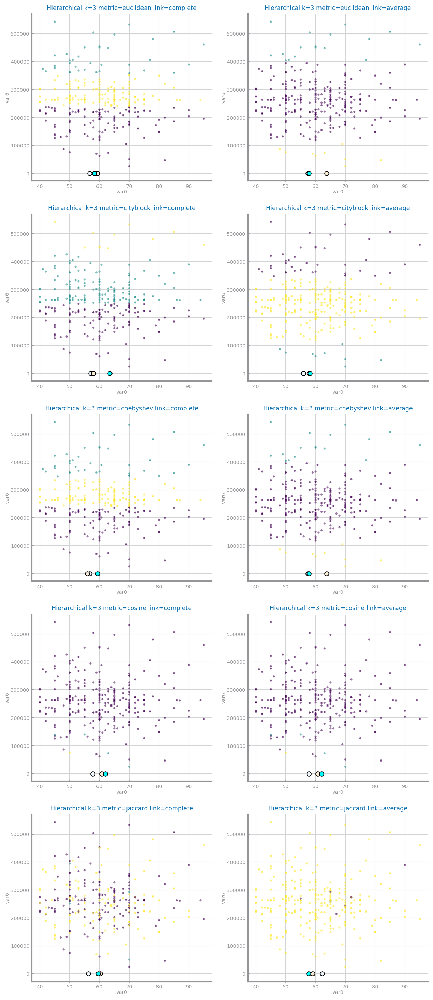

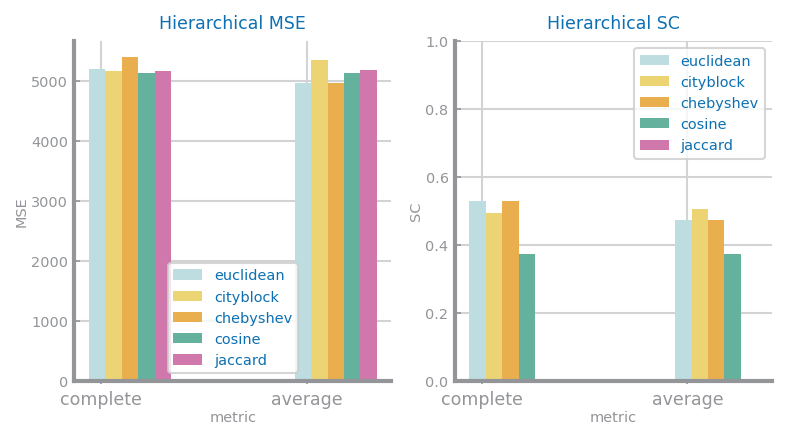

In [3]:
hierarchical(hf_data, 6, 0)

## Feature Extraction

### Without scaling

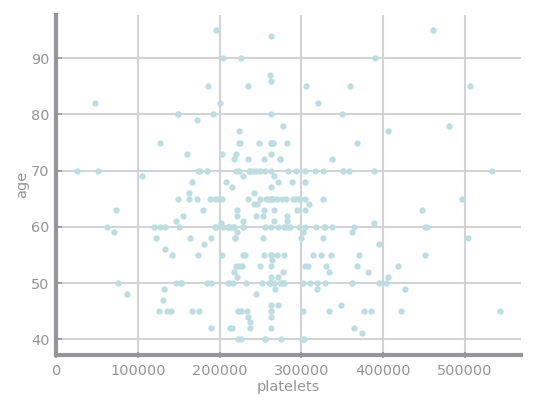

In [19]:
hf_data = get_hf_data(filter_outliers=True, feature_selection=True)
hf_data.pop('DEATH_EVENT')
variables = hf_data.columns.values
eixo_y = 6
eixo_z = 0

plt.figure()
plt.xlabel(variables[eixo_y])
plt.ylabel(variables[eixo_z])
plt.scatter(hf_data.iloc[:, eixo_y], hf_data.iloc[:, eixo_z])
plt.show()

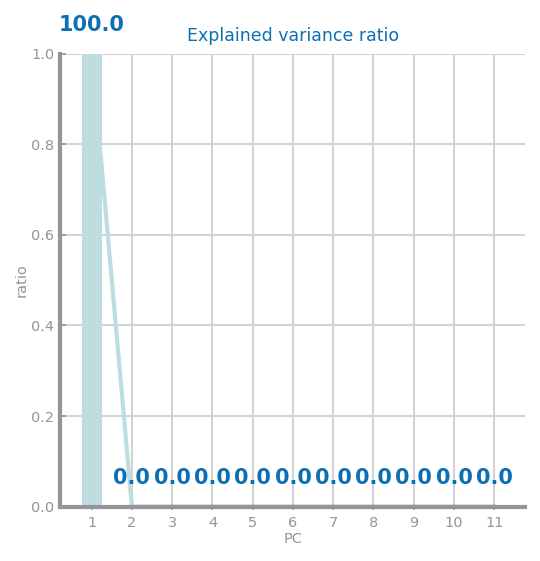

In [20]:
from sklearn.decomposition import PCA

mean = (hf_data.mean(axis=0)).tolist()
centered_data = hf_data - mean
cov_mtx = centered_data.cov()
eigvals, eigvecs = np.linalg.eig(cov_mtx)

pca = PCA()
pca.fit(centered_data)
PC = pca.components_
var = pca.explained_variance_

fig = plt.figure(figsize=(4, 4))
plt.title('Explained variance ratio')
plt.xlabel('PC')
plt.ylabel('ratio')
x_values = [str(i) for i in range(1, len(pca.components_) + 1)]
bwidth = 0.5
ax = plt.gca()
ax.set_xticklabels(x_values)
ax.set_ylim(0.0, 1.0)
ax.bar(x_values, pca.explained_variance_ratio_, width=bwidth)
ax.plot(pca.explained_variance_ratio_)
for i, v in enumerate(pca.explained_variance_ratio_):
    ax.text(i, v+0.05, f'{v*100:.1f}', ha='center', fontweight='bold')
plt.show()

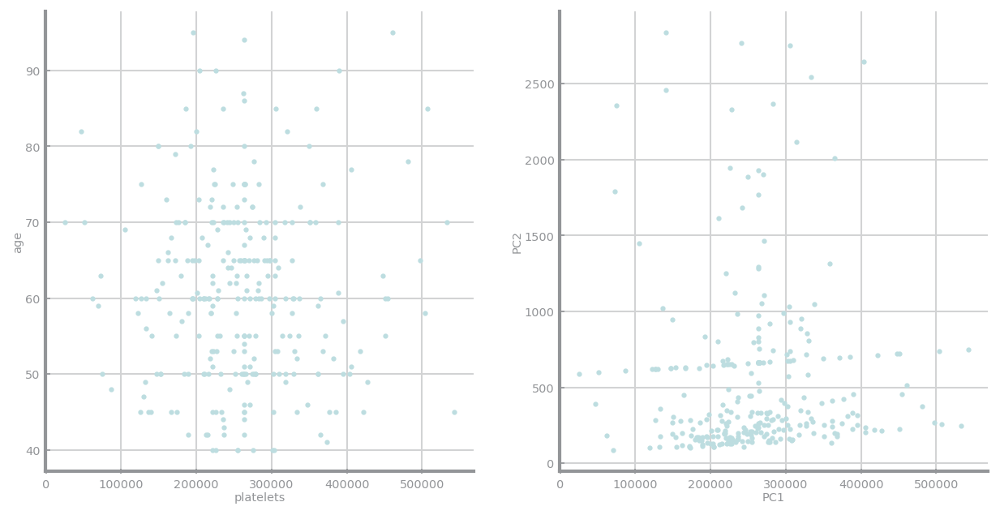

In [21]:
transf = pca.transform(hf_data)

_, axs = plt.subplots(1, 2, figsize=(2*5, 1*5), squeeze=False)
axs[0,0].set_xlabel(variables[eixo_y])
axs[0,0].set_ylabel(variables[eixo_z])
axs[0,0].scatter(hf_data.iloc[:, eixo_y], hf_data.iloc[:, eixo_z])

axs[0,1].set_xlabel('PC1')
axs[0,1].set_ylabel('PC2')
axs[0,1].scatter(transf[:, 0], transf[:, 1])
plt.show()

## Clustering comparison after PCA

In [22]:
data = pd.DataFrame(transf[:,:2], columns=['PC1', 'PC2'])
eixo_x = 0
eixo_y = 1

#data = data[data['PC1'] < 50000]

### K-Means

100%|██████████| 15/15 [00:01<00:00,  7.62it/s]


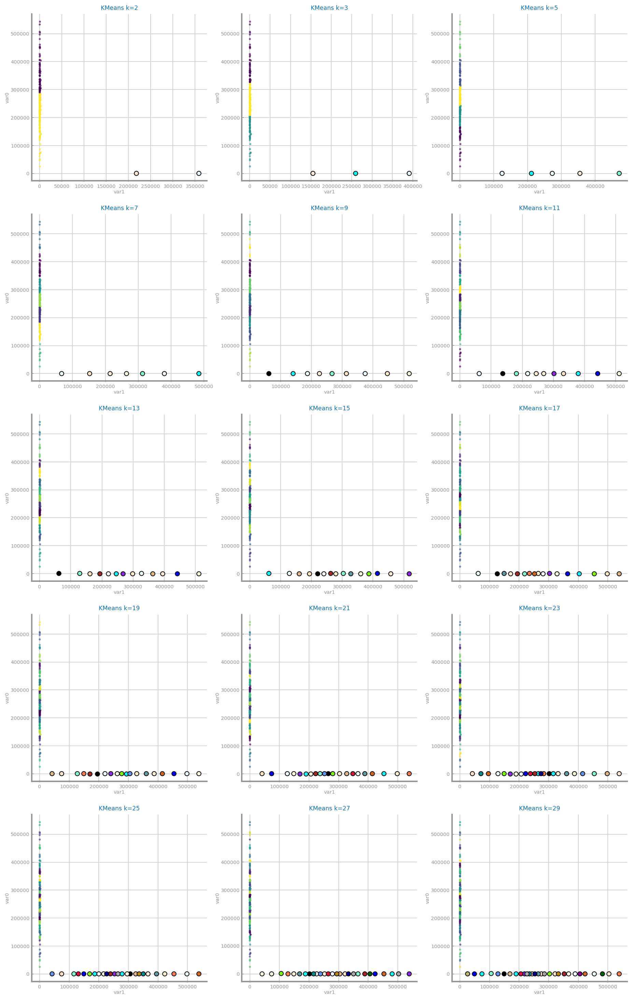

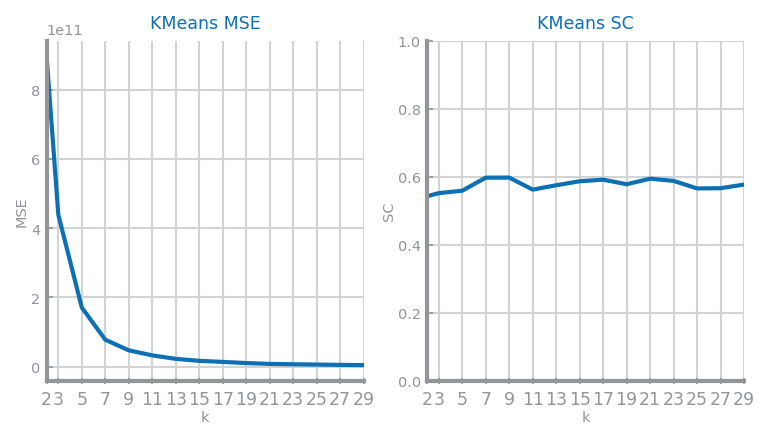

In [23]:
N_CLUSTERS = [2, 3, 5, 7, 9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29]
cluster_Kmeans(data, eixo_x, eixo_y, N_CLUSTERS, estimatorType='Kmeans')

### EM (Expectation-Maximization)

100%|██████████| 15/15 [00:02<00:00,  5.29it/s]


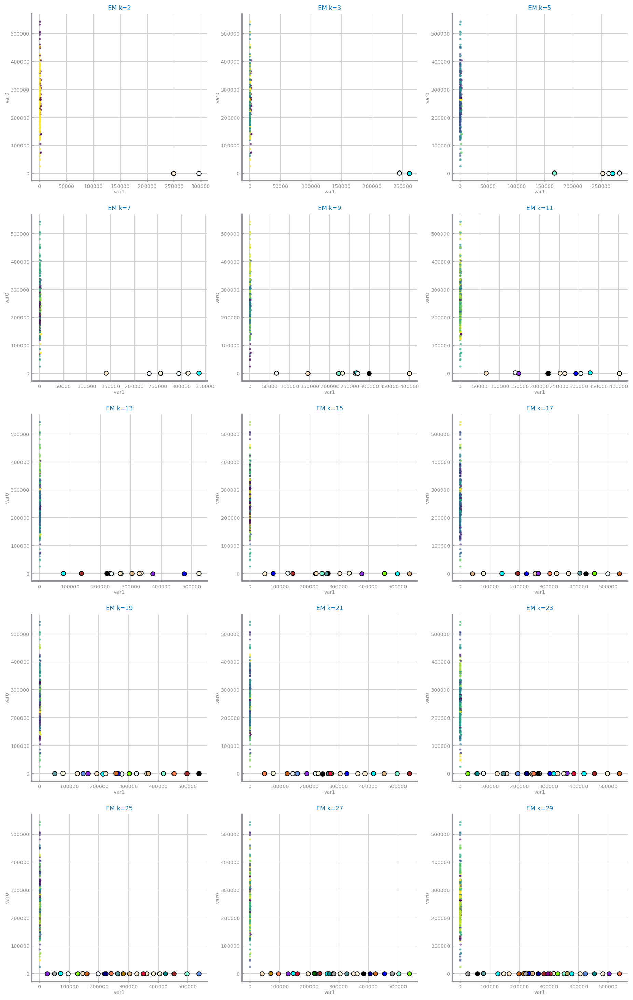

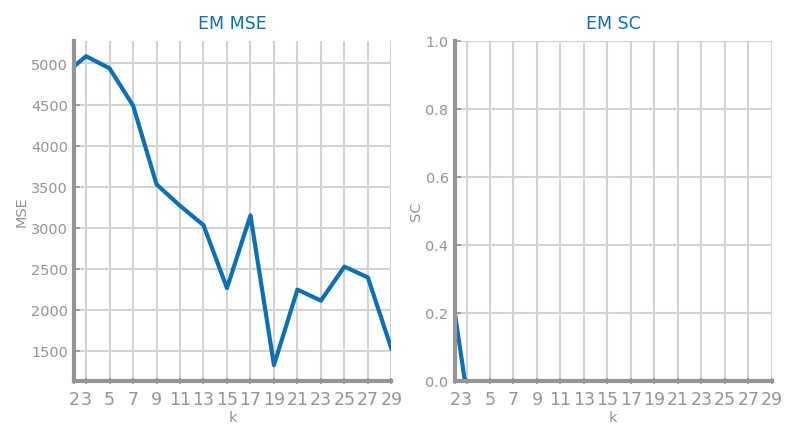

In [24]:
cluster_Kmeans(data, eixo_x, eixo_y, N_CLUSTERS, estimatorType='Gaussian')

### Density-based

#### EPS - studying the maximum distance impact

100%|██████████| 12/12 [00:00<00:00, 20.04it/s]


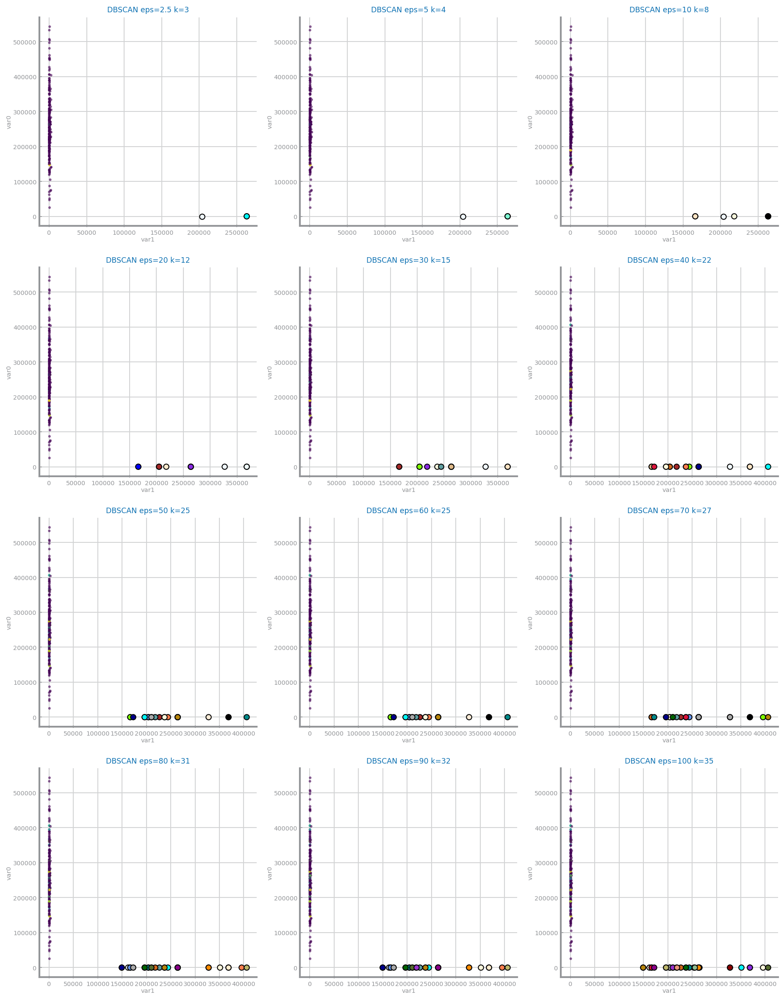

In [25]:
EPS = [2.5, 5, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
densityBasedCluster(data, eixo_x, eixo_y, EPS)

### Metric

AVG distances among records [93193.4092185266, 93673.93529276321, 93184.6754344971, 1.2765199313189573e-05, 0.9964664310954063]
CHOSEN EPS [55916.04553111596, 80, 55910.80526069826, 1.2765199313189574e-06, 0.14946996466431095]


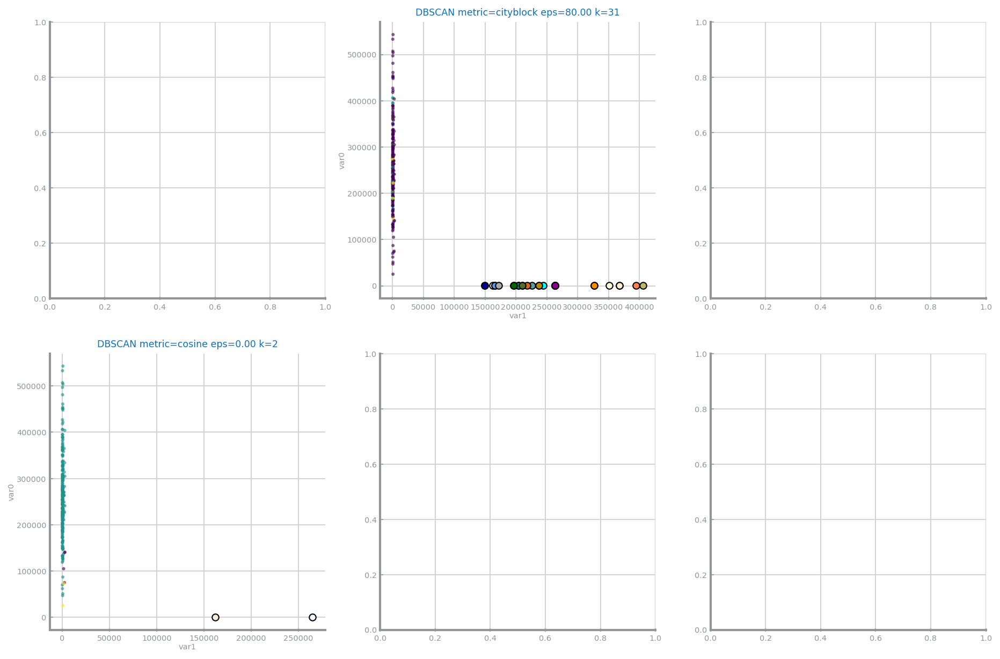

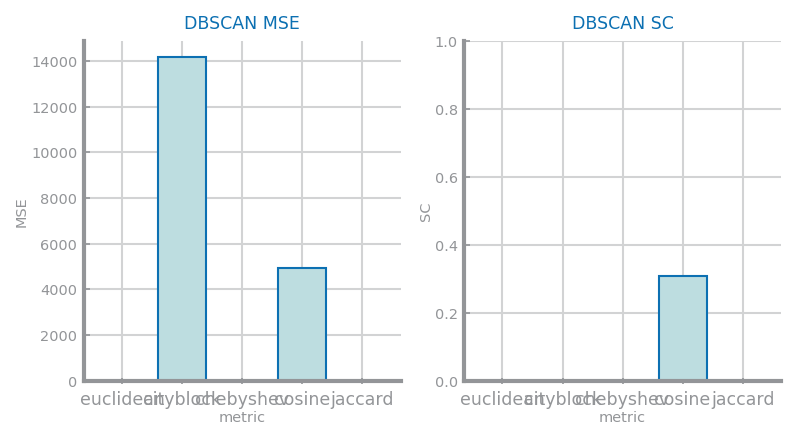

In [26]:
metric(data, eixo_x, eixo_y)

### Hierachical

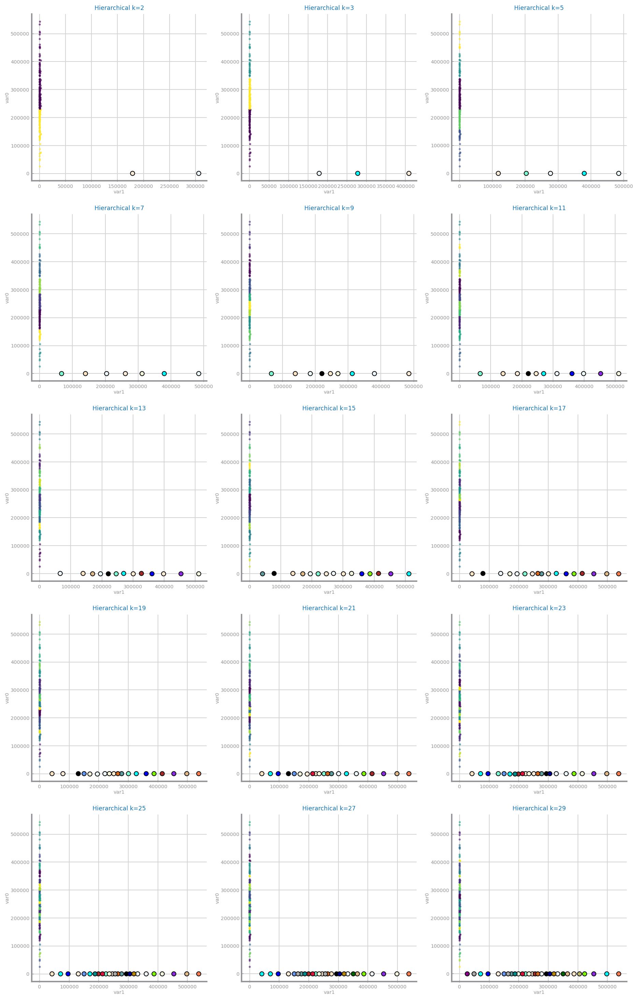

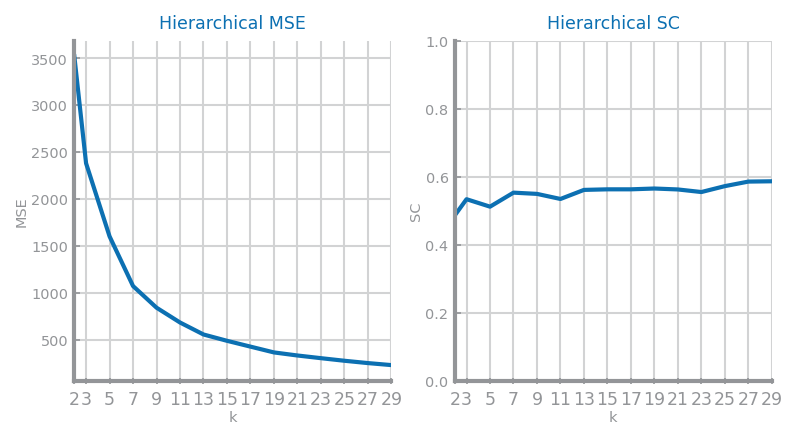

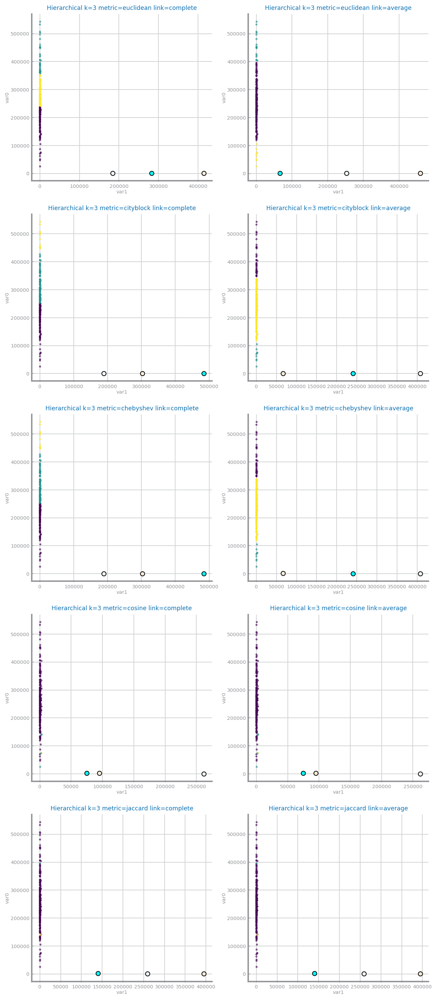

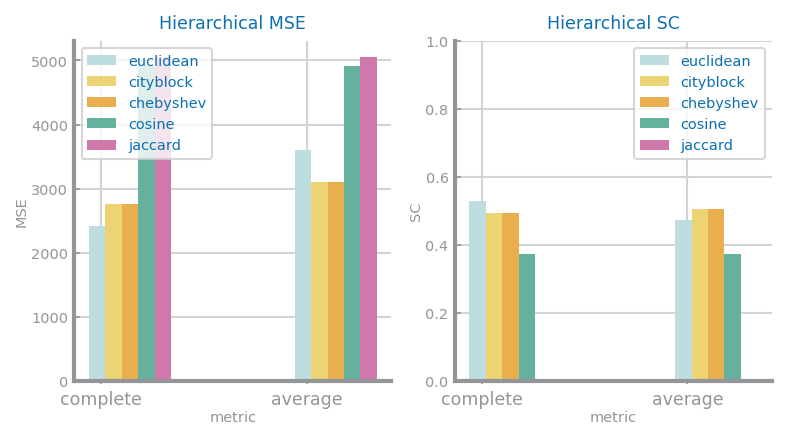

In [27]:
hierarchical(data, eixo_x, eixo_y)

### With scaling

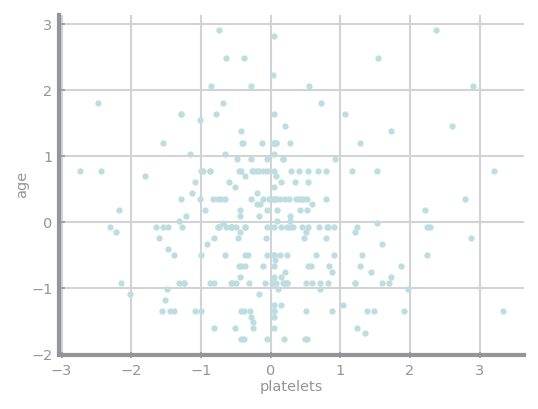

In [10]:
hf_data = get_hf_data(filter_outliers=True, feature_selection=True, scaling='z-score')
hf_data.pop('DEATH_EVENT')
variables = hf_data.columns.values
eixo_y = 6
eixo_z = 0

plt.figure()
plt.xlabel(variables[eixo_y])
plt.ylabel(variables[eixo_z])
plt.scatter(hf_data.iloc[:, eixo_y], hf_data.iloc[:, eixo_z])
plt.show()

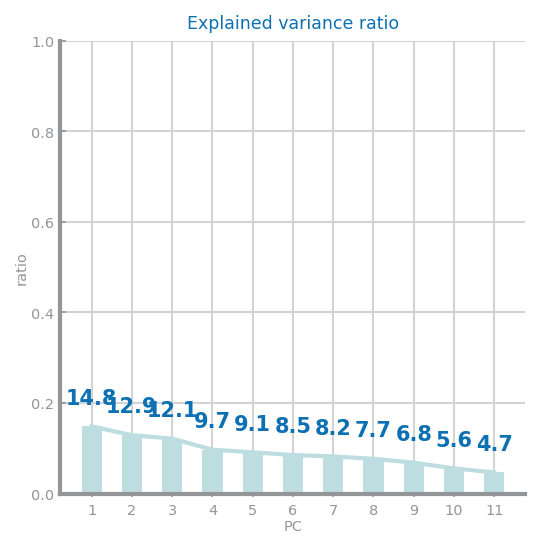

In [11]:
from sklearn.decomposition import PCA

mean = (hf_data.mean(axis=0)).tolist()
centered_data = hf_data - mean
cov_mtx = centered_data.cov()
eigvals, eigvecs = np.linalg.eig(cov_mtx)

pca = PCA()
pca.fit(centered_data)
PC = pca.components_
var = pca.explained_variance_

fig = plt.figure(figsize=(4, 4))
plt.title('Explained variance ratio')
plt.xlabel('PC')
plt.ylabel('ratio')
x_values = [str(i) for i in range(1, len(pca.components_) + 1)]
bwidth = 0.5
ax = plt.gca()
ax.set_xticklabels(x_values)
ax.set_ylim(0.0, 1.0)
ax.bar(x_values, pca.explained_variance_ratio_, width=bwidth)
ax.plot(pca.explained_variance_ratio_)
for i, v in enumerate(pca.explained_variance_ratio_):
    ax.text(i, v+0.05, f'{v*100:.1f}', ha='center', fontweight='bold')
plt.show()

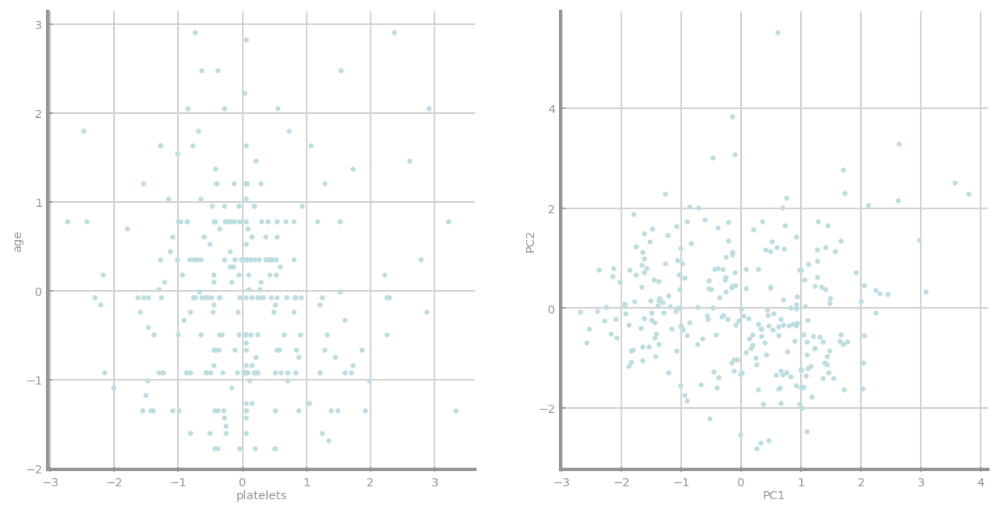

In [12]:
transf = pca.transform(hf_data)

_, axs = plt.subplots(1, 2, figsize=(2*5, 1*5), squeeze=False)
axs[0,0].set_xlabel(variables[eixo_y])
axs[0,0].set_ylabel(variables[eixo_z])
axs[0,0].scatter(hf_data.iloc[:, eixo_y], hf_data.iloc[:, eixo_z])

axs[0,1].set_xlabel('PC1')
axs[0,1].set_ylabel('PC2')
axs[0,1].scatter(transf[:, 0], transf[:, 1])
plt.show()

## Clustering comparison after PCA

In [13]:
data = pd.DataFrame(transf[:,:2], columns=['PC1', 'PC2'])
eixo_x = 0
eixo_y = 1

#data = data[data['PC1'] < 50000]

### K-Means

100%|██████████| 15/15 [00:02<00:00,  7.49it/s]


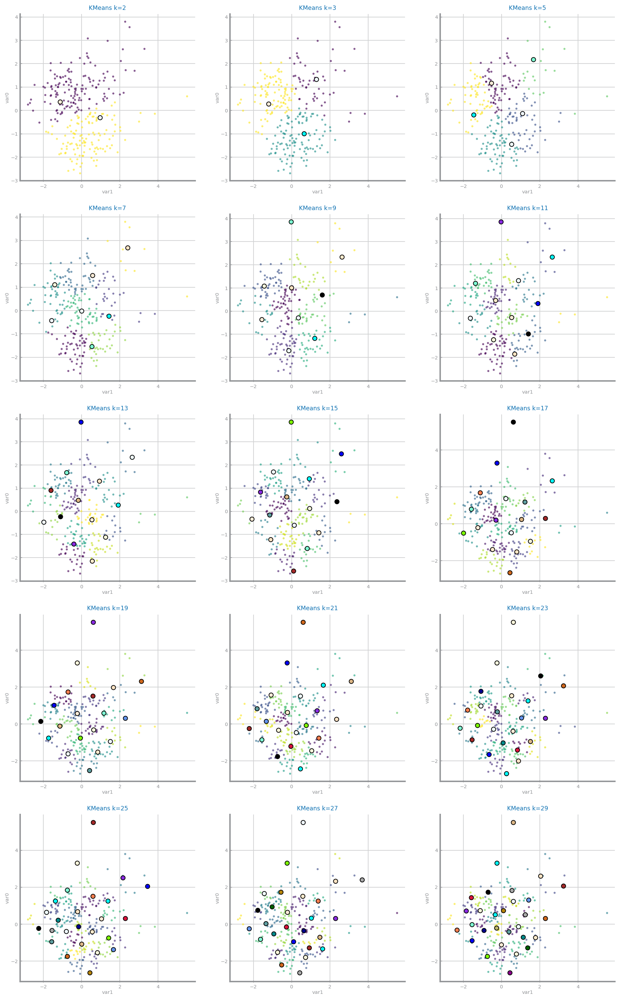

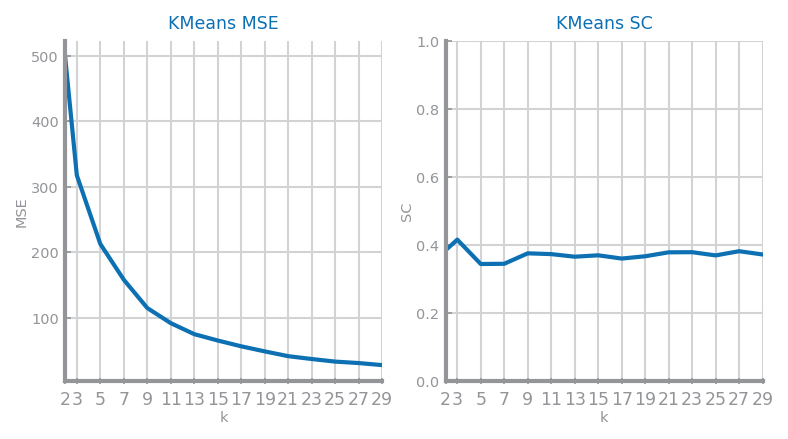

In [14]:
N_CLUSTERS = [2, 3, 5, 7, 9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29]
cluster_Kmeans(data, eixo_x, eixo_y, N_CLUSTERS, estimatorType='Kmeans')

### EM (Expectation-Maximization)

100%|██████████| 15/15 [00:01<00:00,  7.77it/s]


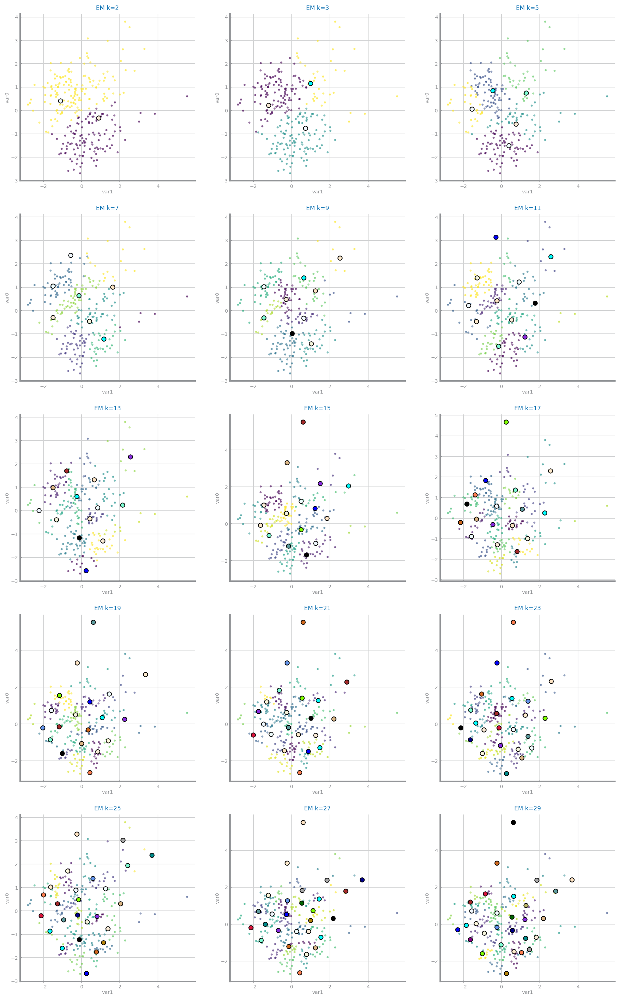

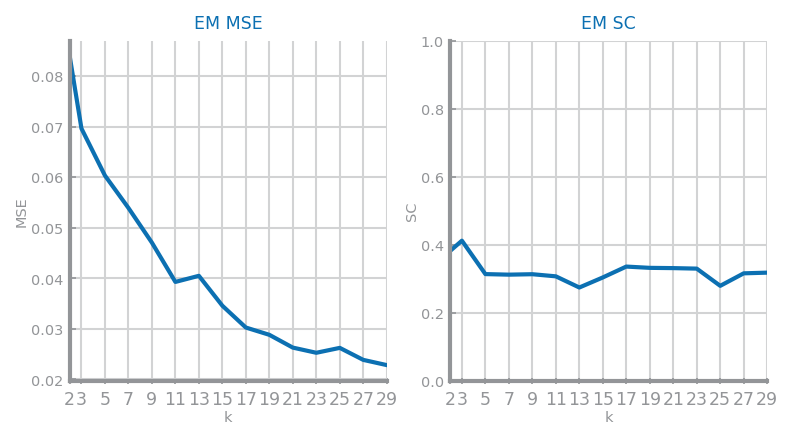

In [15]:
cluster_Kmeans(data, eixo_x, eixo_y, N_CLUSTERS, estimatorType='Gaussian')

### Density-based

#### EPS - studying the maximum distance impact

100%|██████████| 12/12 [00:00<00:00, 291.74it/s]


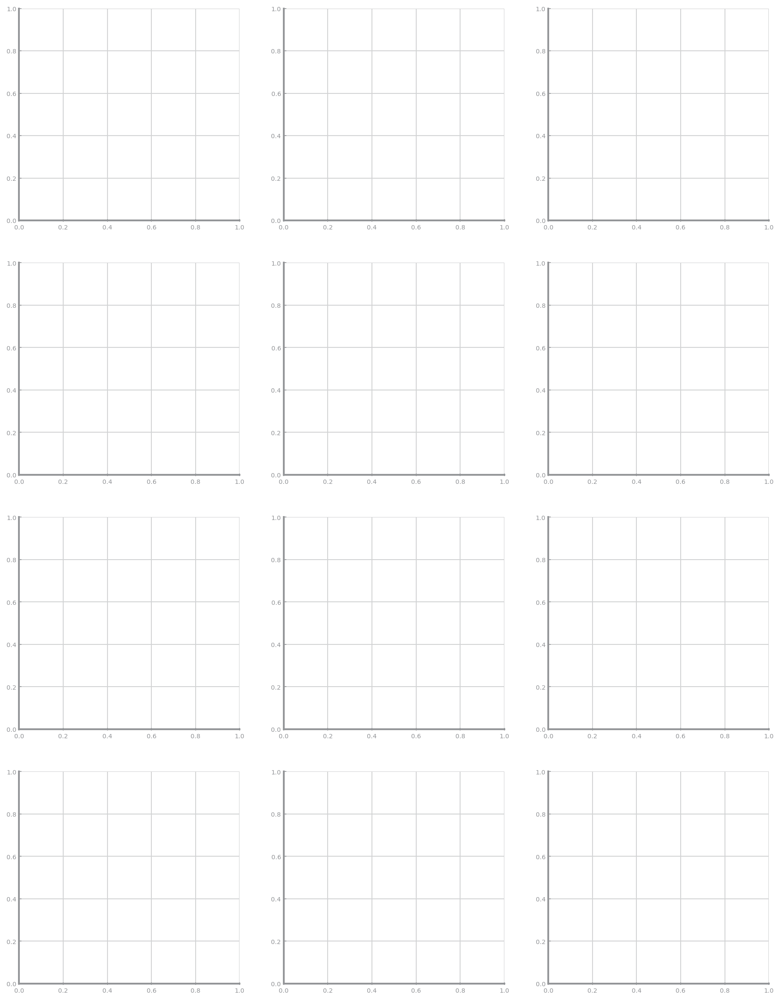

In [16]:
EPS = [2.5, 5, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
densityBasedCluster(data, eixo_x, eixo_y, EPS)

### Metric

AVG distances among records [2.18381532201271, 2.7803372559942177, 1.9667083348534353, 0.9969694493205269, 0.996268656716418]
CHOSEN EPS [1.310289193207626, 80, 1.1800250009120612, 0.0996969449320527, 0.14944029850746268]


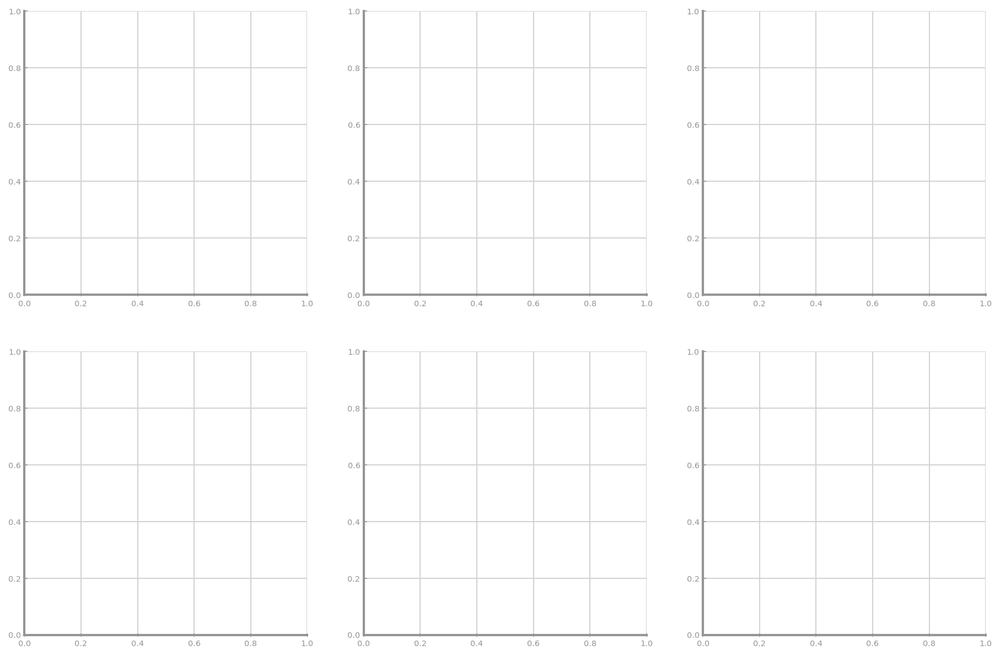

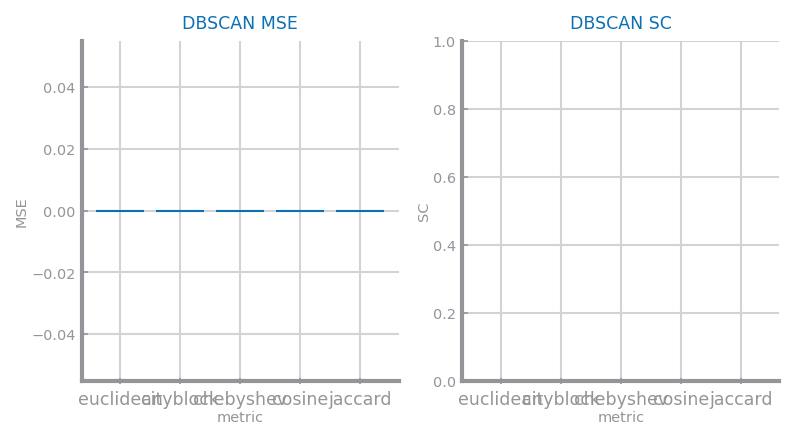

In [17]:
metric(data, eixo_x, eixo_y)

### Hierachical

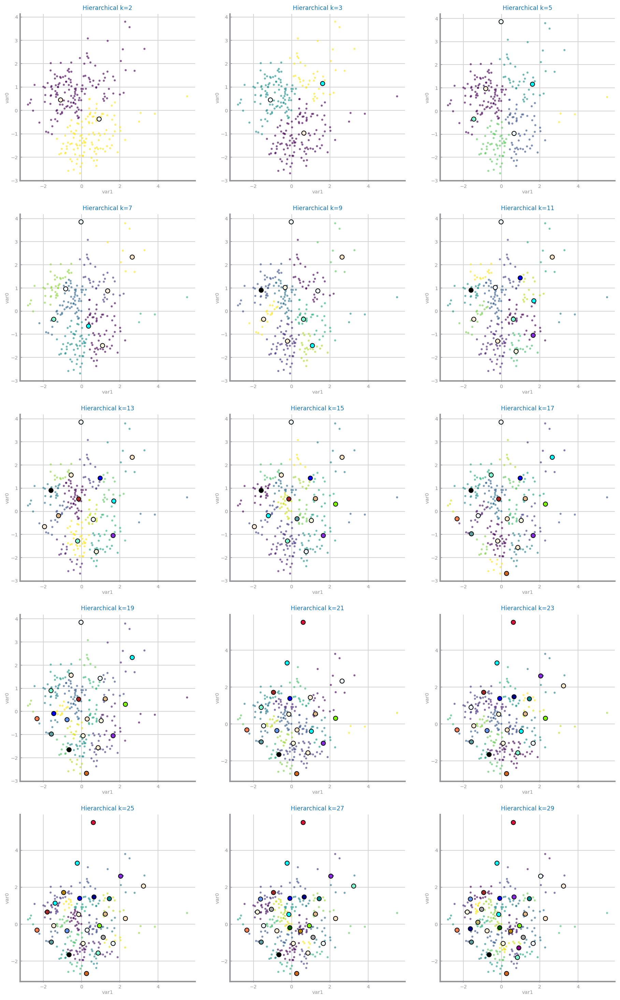

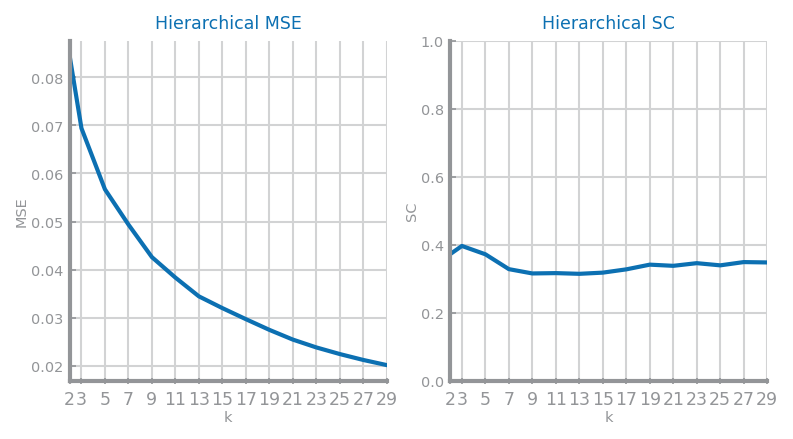

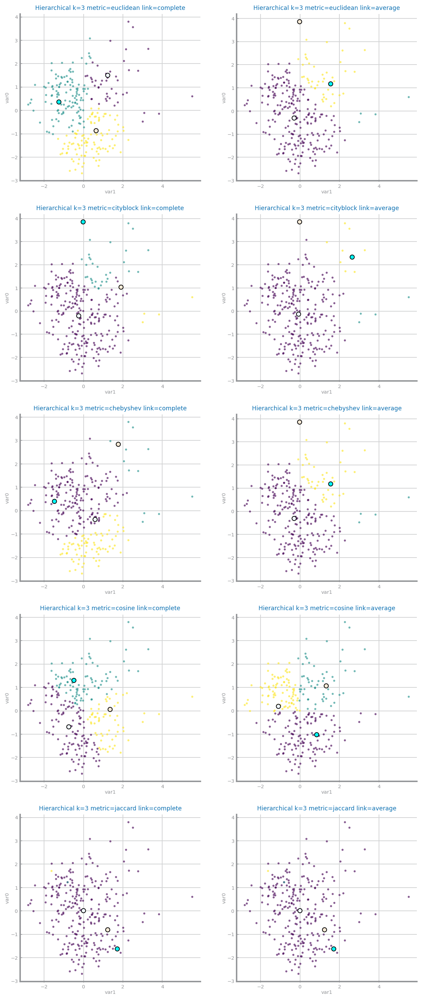

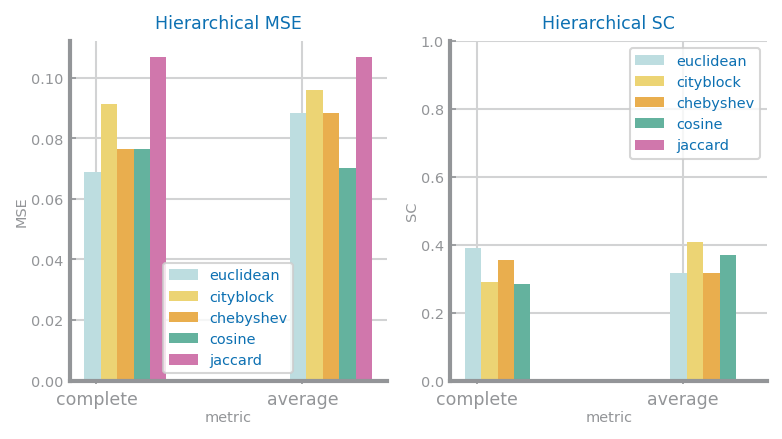

In [18]:
hierarchical(data, eixo_x, eixo_y)

# Toxicity

In [83]:
t_data = get_t_data(feature_selection=True)
t_data.pop('toxic')

pass

## Density-based

### EPS - studying the maximum distance impact

100%|██████████| 4/4 [14:02<00:00, 210.62s/it]


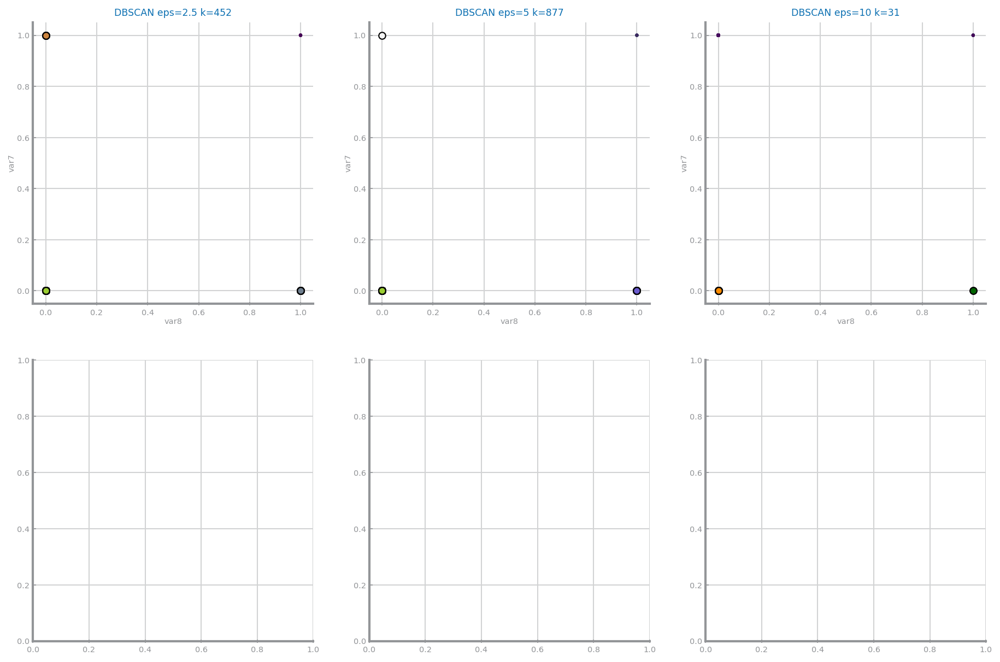

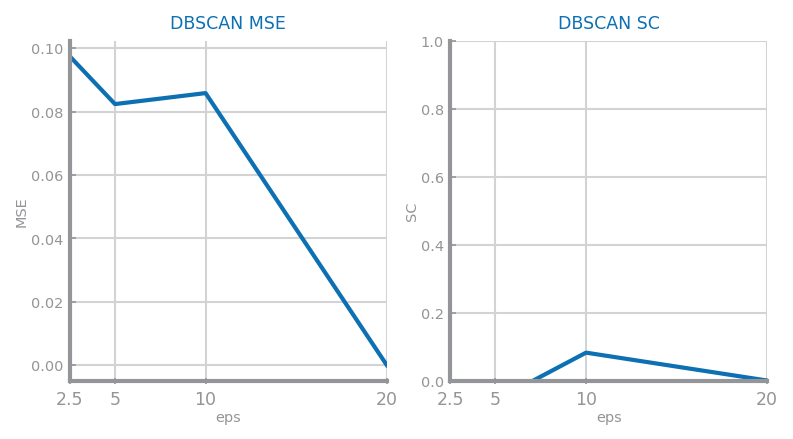

In [3]:
EPS = [2.5]
cluster_Kmeans(t_data, 7, 8, EPS, estimatorType='EPS')

## Feature Extraction

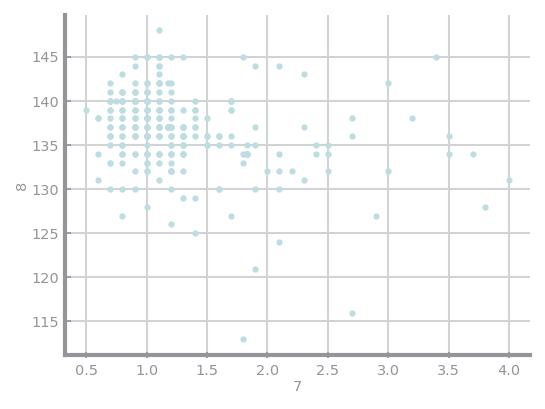

In [84]:
variables = t_data.columns.values
eixo_y = 7
eixo_z = 8

plt.figure()
plt.xlabel(variables[eixo_y])
plt.ylabel(variables[eixo_z])
plt.scatter(hf_data.iloc[:, eixo_y], hf_data.iloc[:, eixo_z])
plt.show()

  7%|▋         | 1/15 [00:20<04:48, 20.64s/it]


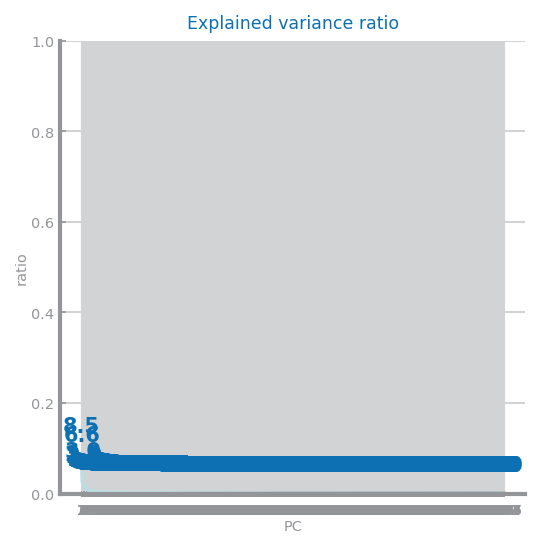

In [89]:
from sklearn.decomposition import PCA

mean = (t_data.mean(axis=0)).tolist()
centered_data = t_data - mean
cov_mtx = centered_data.cov()
eigvals, eigvecs = np.linalg.eig(cov_mtx)

pca = PCA()
pca.fit(centered_data)
PC = pca.components_
var = pca.explained_variance_

fig = plt.figure(figsize=(4, 4))
plt.title('Explained variance ratio')
plt.xlabel('PC')
plt.ylabel('ratio')
x_values = [str(i) for i in range(1, len(pca.components_) + 1)]
bwidth = 0.5
ax = plt.gca()
ax.set_xticklabels(x_values)
ax.set_ylim(0.0, 1.0)
ax.bar(x_values, pca.explained_variance_ratio_, width=bwidth)
ax.plot(pca.explained_variance_ratio_)
for i, v in enumerate(pca.explained_variance_ratio_):
    ax.text(i, v+0.05, f'{v*100:.1f}', ha='center', fontweight='bold')
plt.show()

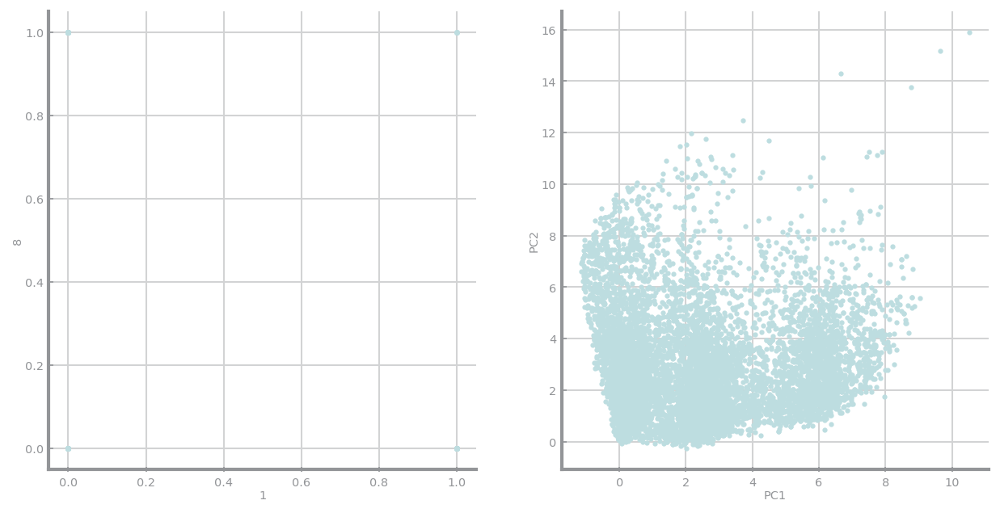

In [90]:
transf = pca.transform(t_data)

_, axs = plt.subplots(1, 2, figsize=(2*5, 1*5), squeeze=False)
axs[0,0].set_xlabel(variables[eixo_y])
axs[0,0].set_ylabel(variables[eixo_z])
axs[0,0].scatter(t_data.iloc[:, eixo_y], t_data.iloc[:, eixo_z])

axs[0,1].set_xlabel('PC1')
axs[0,1].set_ylabel('PC2')
axs[0,1].scatter(transf[:, 0], transf[:, 1])
plt.show()

## Clustering comparison after PCA

In [91]:
data = pd.DataFrame(transf[:,:2], columns=['PC1', 'PC2'])
eixo_x = 0
eixo_y = 1

### K-Means

100%|██████████| 15/15 [00:35<00:00,  2.39s/it]


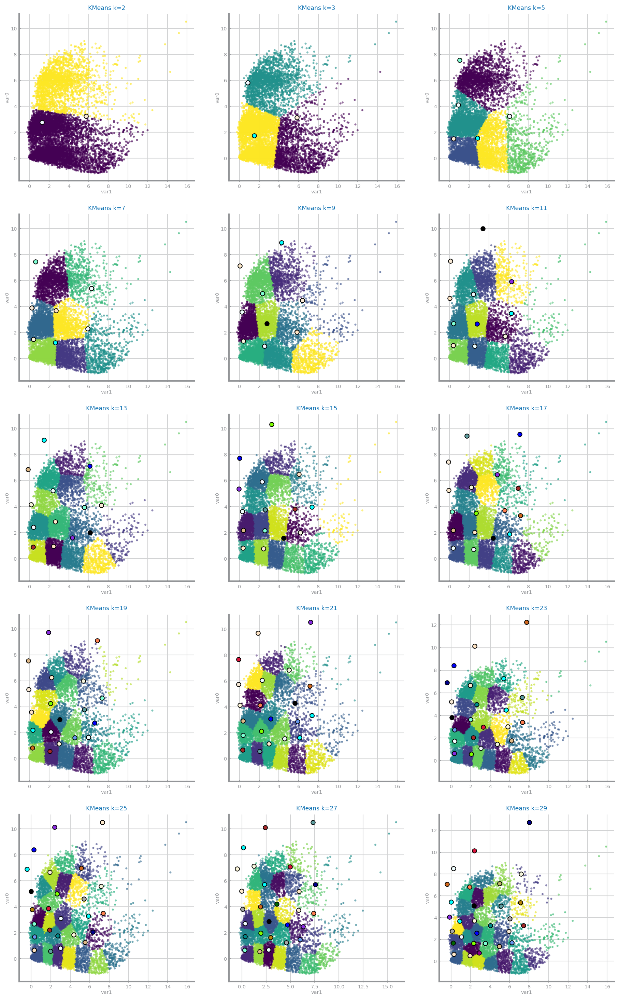

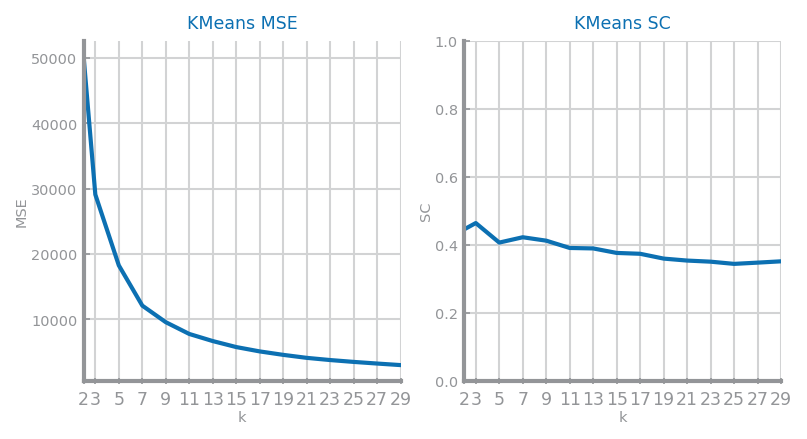

In [92]:
N_CLUSTERS = [2, 3, 5, 7, 9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29]
cluster_Kmeans(data, eixo_x, eixo_y, N_CLUSTERS, estimatorType='Kmeans')

### EM (Expectation-Maximization)

100%|██████████| 15/15 [00:20<00:00,  1.37s/it]


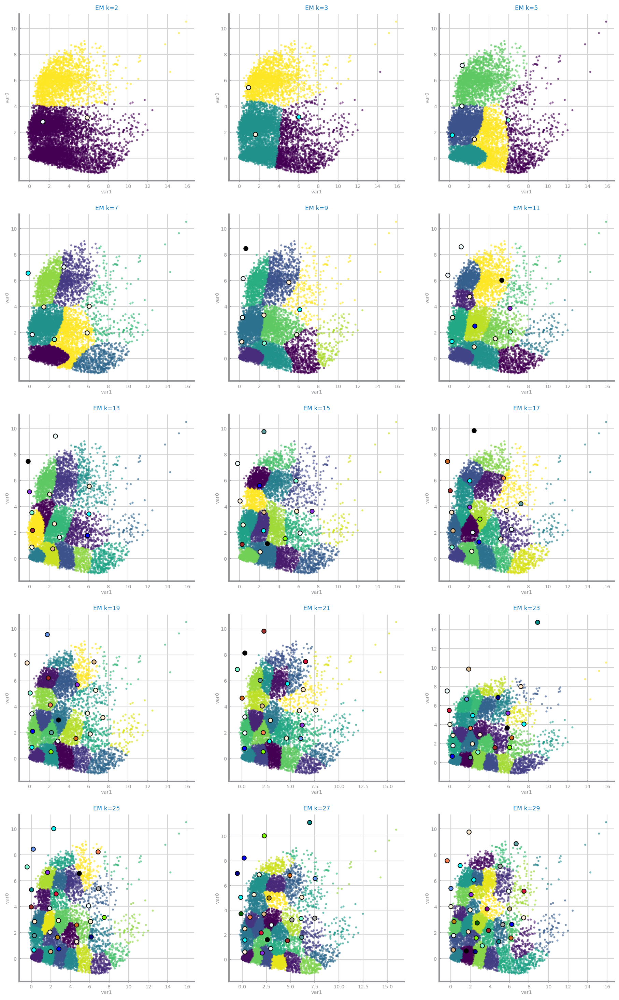

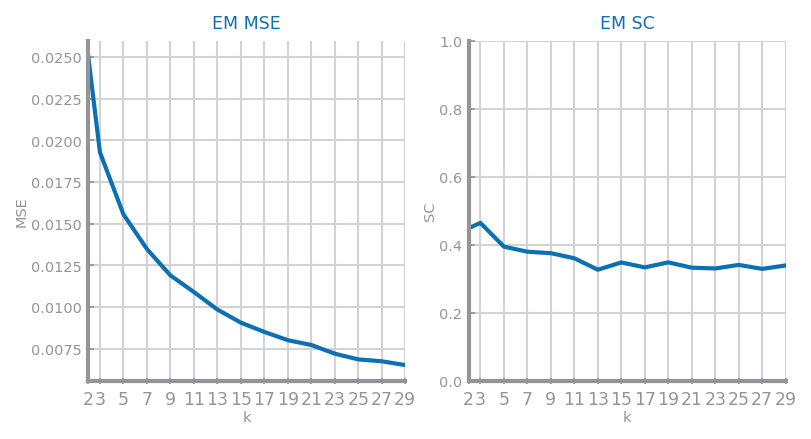

In [93]:
cluster_Kmeans(data, eixo_x, eixo_y, N_CLUSTERS, estimatorType='Gaussian')

### Density-based

#### EPS - studying the maximum distance impact

100%|██████████| 8/8 [00:10<00:00,  1.28s/it]


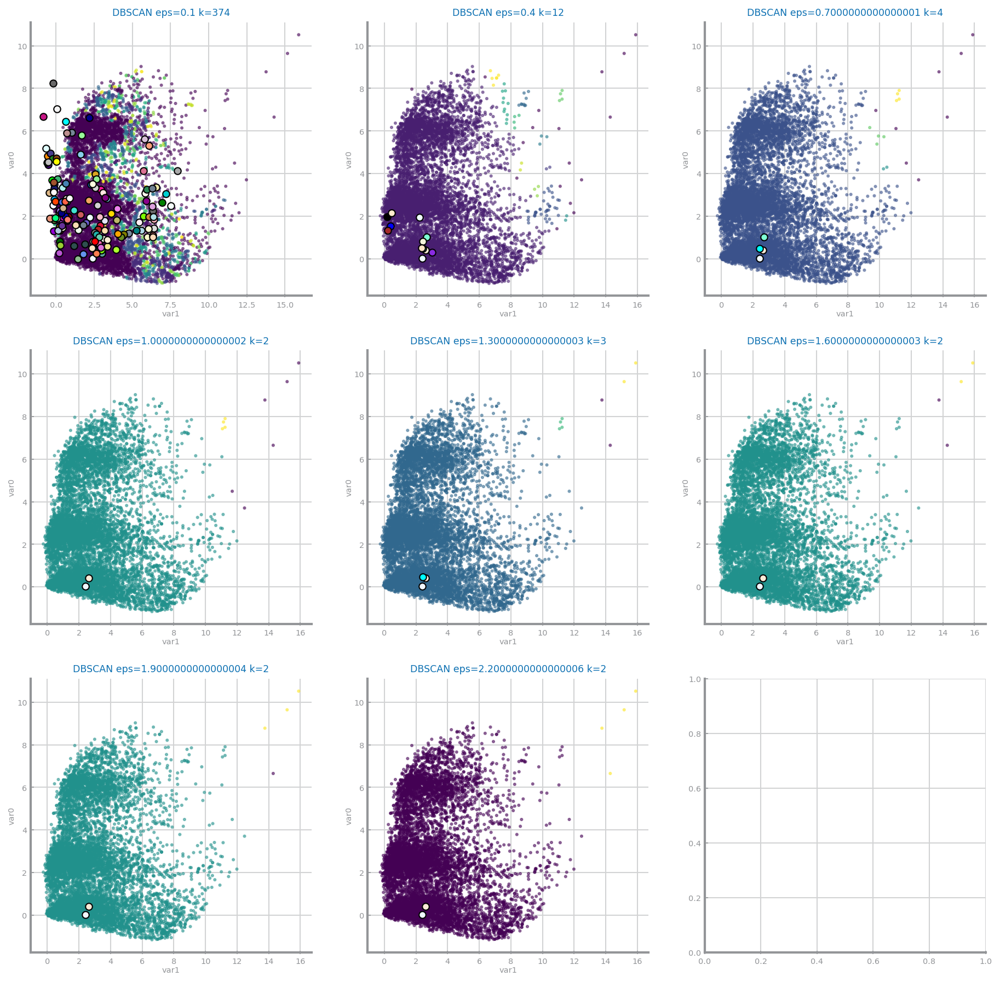

In [100]:
EPS = list(np.arange(0.1, 2.5, 0.3))
densityBasedCluster(data, eixo_x, eixo_y, EPS)

### Metric

AVG distances among records [3.8239689126072856, 4.821850650237756, 3.4738551943215024, 0.2299703397539057, 0.9998726131412976]
CHOSEN EPS [2.294381347564371, 80, 2.0843131165929014, 0.022997033975390574, 0.14998089197119463]


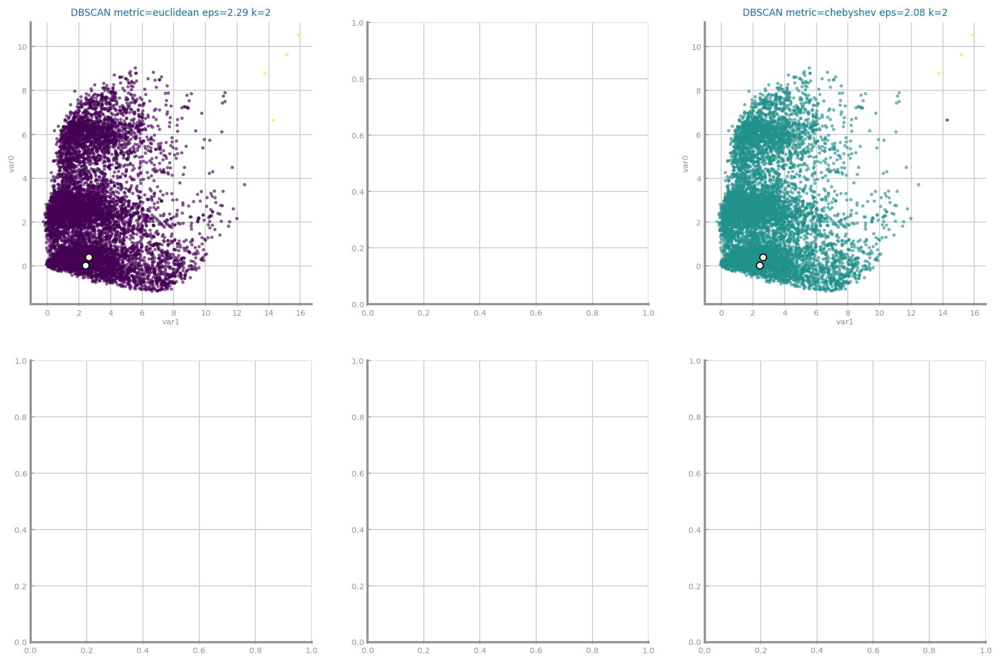

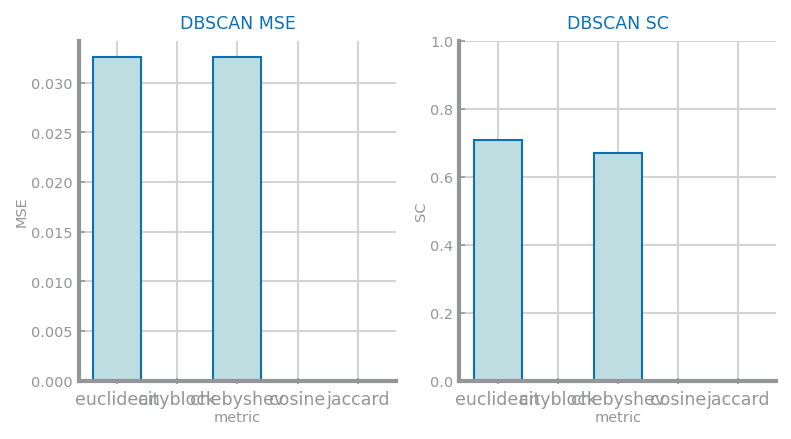

In [95]:
metric(data, eixo_x, eixo_y)

### Hierachical

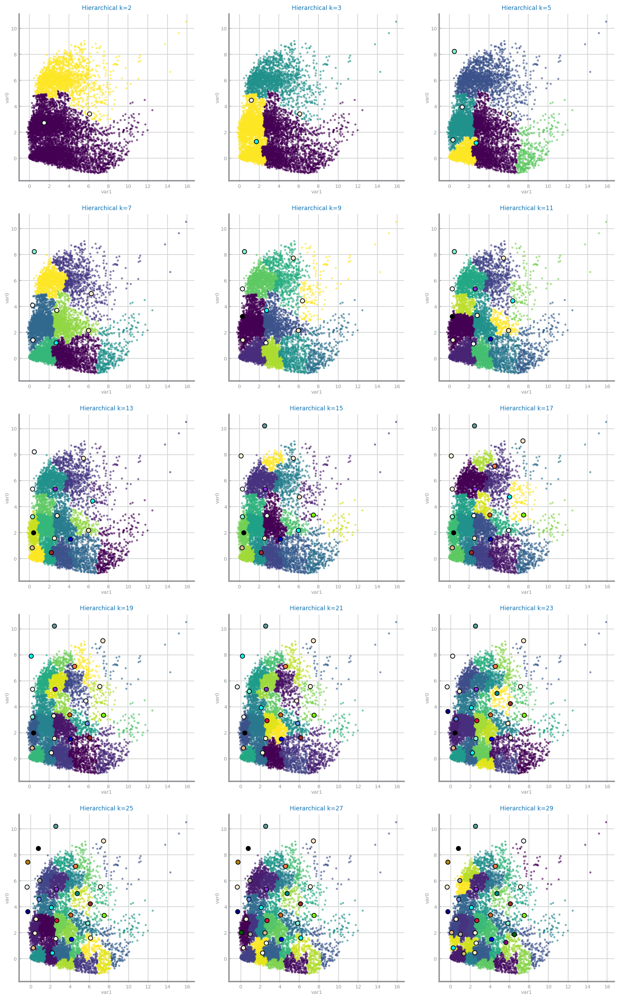

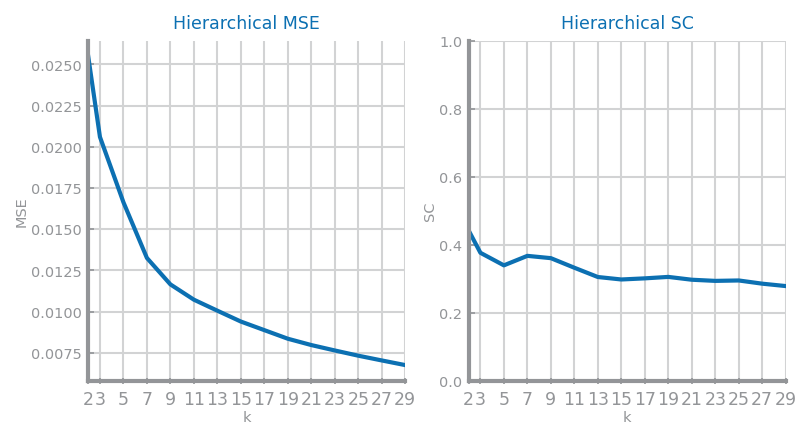

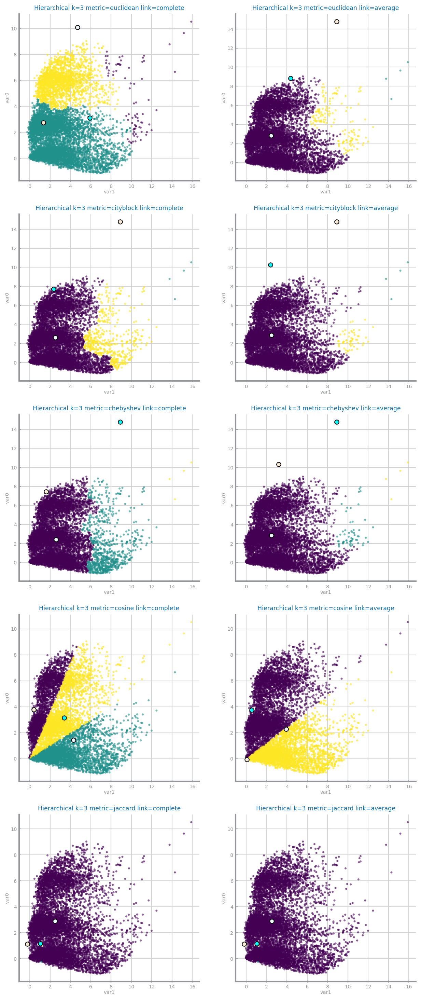

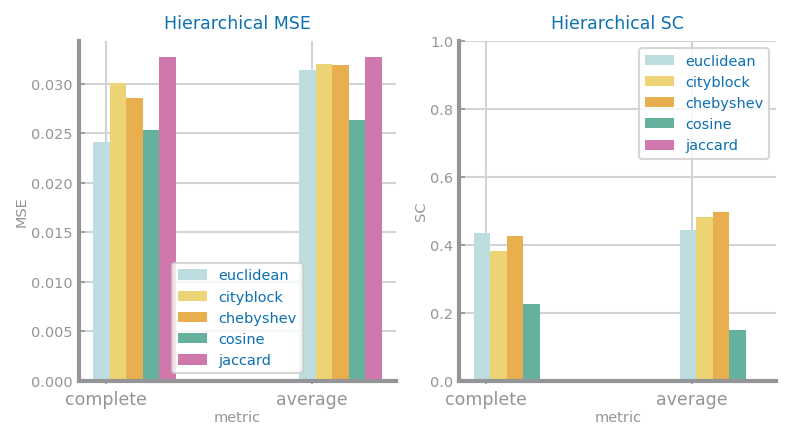

In [96]:
hierarchical(data, eixo_x, eixo_y)